#### Пример №1. Уравнение параболического типа
$$
\begin{cases}  \frac{\partial u}{\partial t} = a \frac{\partial^{2} u}{\partial x^2}, a > 0  \\u(0, t) = 0\\u(1, t) = 0\\u(x, 0) = sin(2 \pi x)\end{cases} 
$$
Аналитическое решение: $ u(x, t) = exp(-4\pi^{2}at)sin(2\pi x) $ <br>

Для решения начально-краевой задачи, в данной работе, используется метод сеток.


Вводим начальные условия:
$$ u(x, 0) = sin(2\pi x) $$
Вводим граничные условия:
$$ u(0, t) = 0, u(1, t) = 0 $$

Выполняем построение сетки
$$h - шаг\:сетки\:в\:направлении\:x;$$
$$\tau - шаг\:сетки\:в\:направлении\:t.$$
координаты узлов сетки
$$x_{i} = ih, i = 0,1,...,n, h = a/n;$$
$$t_{j} = j\tau, j = 0,1,...,m, \tau = T/m.$$
$$x_{n} = nh = a; t_{m} = m\tau = T$$
значение функции
$$u_{i,j} = u(x_{i}, t_{j})$$

Конечно-разностный вид уравнения
$$\frac{u_{i,j}-u_{i,j-1}}{\tau} = a\frac{u_{i+1,j}-2u_{i,j}+u_{i-1,j}}{h^{2}};$$
$$\lambda = \frac{\tau a}{h^{2}};$$
$$\lambda u_{i-1,j}-(1+2\lambda)u_{i,j}+\lambda u_{i+1,j} = -u_{i,j-1};$$
$$i = 1,...,n-1;\:\:j = 1,...,m$$
погрешность аппроксимации
$$O(\tau + h^{2})$$
![scheme](img/1.jpg)
Свойства разностной схемы:
* $двухслойная;$
* $неявная;$
* $устойчива\:при\:любых\:значениях\:параметра\:\lambda$

Система уравнений
$$\lambda u_{i-1,j}-(1+2\lambda)u_{i,j}+\lambda u_{i+1,j} = -u_{i,j-1}$$
$$i = 1,...,n-1;$$
$$u_{0j} = 0, \: u_{nj} = 0.$$

Алгоритм решения задачи:<br>
$1.\:Задание\:шага\:h,\tau$<br>
$2.\:Проверить\:условие\:сходимости\:\frac{h^{2}}{2 a^{2}}$<br>
$3.\:Вычисление\:решения\:на\:нулевом\:временном\:слое\:\:u_{i0} = sin(2\pi x)$<br>
$4.\:Вычисление\:решения\:на\:каждом\:следующем\:слое$<br>
$(решение\:трехдиагональной\:системы\:уравнений)$<br>
$\lambda u_{i-1,j} - (1+2\lambda)u_{ij} + \lambda u_{i+1,j} = -u_{i,j-1}$<br>
$i = 1,...,n-1;$<br>
$u_{0j} = 0, \:\:u_{nj} = 0.$

In [2]:
# Подключаем необходимые библиотеки
import numpy as np
from IPython.display import HTML
from matplotlib import animation
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

In [16]:
## МОДЕЛИРОВАННОЕ РЕШЕНИЕ
t = 1000+1
xt = 11

dx = 0.1
dt = 0.001

a = 0.1 # При данном значении коэффициента условие
        # условие сходимости выполняется

lambd = dt*a/dx/dx

if dt < dx*dx/2/a/a and dt > 0:
    print("Условие сходимости выполнено.\nДля dx =", dx, " | dt =", dt,
          " | a =", a)
else: 
    print("Условие сходимости не выполнено.\nДля dx =", dx, " | dt =", dt,
          " | a =", a, "\nТ.к. ", dt, " > ", dx*dx/2/a/a)

otv = np.zeros((t, xt))

for i in range(1, xt-1):
    otv[0][i] = np.sin(2*np.pi*i*dx)
    
for i in range(0, t):
    otv[i][0] = 0
    otv[i][10] = 0
    
for i in range(1, t):
    for j in range(1, xt-1):
        otv[i][j] = (1-2*lambd)*otv[i-1][j]+lambd*(otv[i-1][j+1]+otv[i-1][j-1])

Условие сходимости выполнено.
Для dx = 0.1  | dt = 0.001  | a = 0.1


In [17]:
## АНАЛИТИЧЕСКОЕ РЕШЕНИЕ
otvan = np.zeros((t, xt))

for i in range(0, t):
    for j in range(0, xt):
        otvan[i][j] = np.exp(-4*np.pi*np.pi*a*i*dt)*np.sin(2*np.pi*j*dx)


In [18]:
## ПОСТРОЕНИЕ АНИМИРОВАННОГО ГРАФИКА
fig, ax = plt.subplots()
plt.close()

ax.set_xlim((0, xt-1))
ax.set_ylim((-1.1, 1.1))

line1, = ax.plot([], [], lw=3, label='Аналитический график')
line2, = ax.plot([], [], lw=2, linestyle='--',  label='Моделированный график')

ax.grid()
ax.legend(loc=1)

def init():
    line1.set_data([],[])
    line2.set_data([],[])
    return(line1, line2)

def animate(i):
    x=np.arange(xt)
    line1.set_data(x,otvan[i])
    line2.set_data(x,otv[i])
    ax.set_title(str(i*0.001))
    return(line1, line2)

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=t,
                              interval=100, blit=True)
HTML(anim.to_jshtml())

Animation size has reached 20991794 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


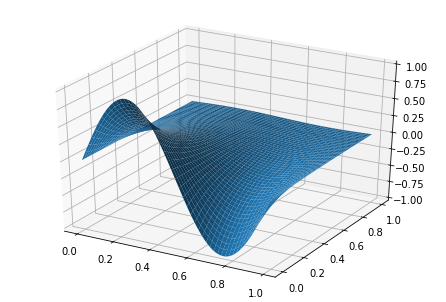

In [19]:
### ТРЁХМЕРНЫЙ ГРАФИК
def makeData():
    x = np.arange(0, 1, 0.01) ## x
    y = np.arange(0, 1, 0.001) ## t
    xgrid, ygrid = np.meshgrid(x, y)

    zgrid = np.exp(-4*np.pi*np.pi*a*ygrid)*np.sin(2*np.pi*xgrid)
    return xgrid, ygrid, zgrid

x, y, z = makeData()
fig = plt.figure()
axes = Axes3D(fig)
axes.plot_surface(x, y, z)
plt.show()